In [1]:
import json
import os
import numpy as np
from pyproj import Proj, Transformer
import matplotlib.pyplot as plt
from typing import Dict, Tuple, List, Optional, Set
import ast
import xml.etree.ElementTree as ET
from datetime import datetime
from dateutil import parser as date_parser
from math import sqrt
from collections import deque, defaultdict
from copy import deepcopy

In [2]:
data_path = '/Users/carlesbalsach/FIB/TFG/GeoFusion Maps/Data/BcnEixample'
msg_file = 'msg.json'
graph_file = 'graph.p'

In [3]:
class KDTree:
    def __init__(self, points, depth=0):
        if not points:
            self.point = None
            self.left = None
            self.right = None
            return
        
        # Alternate splitting axis: even depth -> split by x, odd depth -> split by y
        axis = depth % 2
        points.sort(key=lambda p: p[axis])
        median = len(points) // 2
        
        self.point = points[median]
        self.left = KDTree(points[:median], depth+1) if median > 0 else None
        self.right = KDTree(points[median+1:], depth+1) if median < len(points)-1 else None
        self.axis = axis

    def nearest(self, target, best=None, best_dist=float('inf')):
        if self.point is None:
            return best, best_dist
        
        # Check current node distance
        dist = (self.point[0] - target[0])**2 + (self.point[1] - target[1])**2
        if dist < best_dist:
            best_dist = dist
            best = self.point
        
        # Decide which side to go
        diff = target[self.axis] - self.point[self.axis]
        if diff < 0:
            primary, secondary = self.left, self.right
        else:
            primary, secondary = self.right, self.left
        
        if primary:
            best, best_dist = primary.nearest(target, best, best_dist)
        
        # Check if we need to explore the other branch
        if secondary and diff**2 < best_dist:
            best, best_dist = secondary.nearest(target, best, best_dist)
        
        return best, best_dist

In [4]:
# Information on the Sat2Graph metadata
class GraphMetadata:
    def __init__(self, path, filename):
        # Combine the path and filename to get the full file path
        filepath = os.path.join(path, filename)
        
        # Open and read the JSON file
        with open(filepath, 'r') as file:
            data = json.load(file)
        
        # Initialize class attributes with data from the JSON file
        self.model_id = data.get('model_id')
        self.lon = data.get('lon')
        self.nPhase = data.get('nPhase')
        self.padding = data.get('padding')
        self.stride = data.get('stride')
        self.v_thr = data.get('v_thr')
        self.time = data.get('time')
        self.lat = data.get('lat')
        self.e_thr = data.get('e_thr')
        self.snap_w = data.get('snap_w')
        self.snap_dist = data.get('snap_dist')
        self.size = data.get('size')

    def print(self):
        print(f'lat: {self.lat}, lon: {self.lon}, padding:{self.padding}')


In [5]:
gmd = GraphMetadata(data_path, msg_file)
gmd.print()

lat: 41.386418, lon: 2.150498, padding:16


In [6]:
class Graph:
    def __init__(self, dtype=np.int64):
        """
        Initializes the Graph by loading data from a file.

        Parameters:
        - path (str): The directory path where the file is located.
        - filename (str): The name of the file containing the graph data.
        - dtype (numpy.dtype): The NumPy integer type to use for node identifiers.
                              Defaults to np.int64.
        """
        self.graph: Dict[Tuple[np.integer, np.integer], List[Tuple[np.integer, np.integer]]] = {}
        self.dtype = dtype

    def copy(self, g):
        self.graph = deepcopy(g.graph)
        self.dtype = g.dtype

    def load_graph(self, path: str, filename: str):
        """
        Loads the graph data from the specified file and initializes the graph.

        Parameters:
        - path (str): The directory path where the file is located.
        - filename (str): The name of the file containing the graph data.
        """
        filepath = os.path.join(path, filename)
        try:
            with open(filepath, 'r') as file:
                content = file.read()
                # Safely evaluate the string to a Python dictionary
                data = ast.literal_eval(content)
                
                # Validate that data is a dictionary
                if not isinstance(data, dict):
                    raise ValueError("The file does not contain a valid dictionary.")
                
                # Process each key-value pair
                for key, value in data.items():
                    # Convert key to tuple of NumPy integers
                    if not (isinstance(key, tuple) and len(key) == 2):
                        raise ValueError(f"Invalid key format: {key}. Expected a tuple of two integers.")
                    np_key = tuple(self.dtype(k) for k in key)
                    
                    # Validate and convert value list to list of tuples with NumPy integers
                    if not isinstance(value, list):
                        raise ValueError(f"Invalid value format for key {key}: {value}. Expected a list of tuples.")
                    
                    np_value = []
                    for item in value:
                        if not (isinstance(item, tuple) and len(item) == 2):
                            raise ValueError(f"Invalid edge format: {item}. Expected a tuple of two integers.")
                        np_item = tuple(self.dtype(v) for v in item)
                        np_value.append(np_item)
                    
                    # Assign to graph
                    self.graph[np_key] = np_value
                
                print(f"Graph successfully loaded from {filepath}.")
        except FileNotFoundError:
            print(f"Error: The file {filepath} does not exist.")
        except PermissionError:
            print(f"Error: Permission denied when accessing the file {filepath}.")
        except (SyntaxError, ValueError) as e:
            print(f"Error parsing the file {filepath}: {e}")

    def get_neighbors(self, node: Tuple[np.integer, np.integer]) -> List[Tuple[np.integer, np.integer]]:
        """
        Returns the list of neighbors for a given node.

        Parameters:
        - node (Tuple[np.integer, np.integer]): The node for which neighbors are to be retrieved.

        Returns:
        - List[Tuple[np.integer, np.integer]]: A list of neighboring nodes.
        """
        return self.graph.get(node, [])

    def add_node(self, node: Tuple[int, int]):
        """
        Adds a node to the graph if it doesn't already exist.

        Parameters:
        - node (Tuple[int, int]): The node to be added.
        """
        np_node = tuple(self.dtype(n) for n in node)
        if np_node not in self.graph:
            self.graph[np_node] = []
            #print(f"Node {np_node} added to the graph.")
        #else:
            #print(f"Node {np_node} already exists in the graph.")

    def add_edge(self, node1: Tuple[int, int], node2: Tuple[int, int]):
        """
        Adds an undirected edge between two nodes in the graph.

        Parameters:
        - node1 (Tuple[int, int]): The first node.
        - node2 (Tuple[int, int]): The second node.
        """
        np_node1 = tuple(self.dtype(n) for n in node1)
        np_node2 = tuple(self.dtype(n) for n in node2)
        
        # Add nodes if they don't exist
        if np_node1 not in self.graph:
            self.graph[np_node1] = []
            #print(f"Node {np_node1} added to the graph.")
        if np_node2 not in self.graph:
            self.graph[np_node2] = []
            #print(f"Node {np_node2} added to the graph.")
        
        # Add the edge if it doesn't exist
        if np_node2 not in self.graph[np_node1]:
            self.graph[np_node1].append(np_node2)
            #print(f"Edge added from {np_node1} to {np_node2}.")
        if np_node1 not in self.graph[np_node2]:
            self.graph[np_node2].append(np_node1)
            #print(f"Edge added from {np_node2} to {np_node1}.")

    def remove_node(self, node: Tuple[float, float]):
        np_node = tuple(self.dtype(n) for n in node)
        if np_node in self.graph:
            del self.graph[np_node]
            for neighbors in self.graph.values():
                if np_node in neighbors:
                    neighbors.remove(np_node)
            #print(f"Node {np_node} removed from the graph.")

    def delete_node_based_on_connections(self, node: Tuple[np.integer, np.integer]) -> bool:
        """
        Deletes a node from the graph based on the number of its connections.

        - If the node has only one connection:
            - Remove the connection from its neighbor.
            - Delete the node from the graph.
        
        - If the node has exactly two connections:
            - Connect the two neighboring nodes directly (if not already connected).
            - Remove the connections from both neighbors to the node.
            - Delete the node from the graph.

        Parameters:
        - node (Tuple[int, int]): The node to be evaluated and potentially deleted.

        Returns:
        - bool: True if the node was deleted, False otherwise.
        """
        np_node = tuple(self.dtype(n) for n in node)
        
        if np_node not in self.graph:
            #print(f"Node {np_node} does not exist in the graph.")
            return False

        neighbors = self.graph[np_node]
        num_connections = len(neighbors)

        if num_connections == 1:
            # Single connection: Remove the connection and delete the node
            neighbor = neighbors[0]
            if neighbor in self.graph:
                if np_node in self.graph[neighbor]:
                    self.graph[neighbor].remove(np_node)
                    #print(f"Removed connection from {neighbor} to {np_node}.")
            del self.graph[np_node]
            print(f"Node {np_node} deleted (single connection).")
            return True

        elif num_connections == 2:
            # Double connection: Connect the two neighbors, remove connections to the node, and delete the node
            neighbor1, neighbor2 = neighbors
            if neighbor1 == neighbor2:
                # Both neighbors are the same node (self-loop scenario)
                # Remove the connection and delete the node
                if neighbor1 in self.graph:
                    if np_node in self.graph[neighbor1]:
                        self.graph[neighbor1].remove(np_node)
                        #print(f"Removed self-loop connection from {neighbor1} to {np_node}.")
                del self.graph[np_node]
                #print(f"Node {np_node} deleted (self-loop).")
                return True

            # Add edge between neighbor1 and neighbor2 if not already present
            if neighbor2 not in self.graph[neighbor1]:
                self.graph[neighbor1].append(neighbor2)
                #print(f"Added connection from {neighbor1} to {neighbor2}.")
            if neighbor1 not in self.graph[neighbor2]:
                self.graph[neighbor2].append(neighbor1)
                #print(f"Added connection from {neighbor2} to {neighbor1}.")

            # Remove the connections from neighbors to the node
            if np_node in self.graph[neighbor1]:
                self.graph[neighbor1].remove(np_node)
                #print(f"Removed connection from {neighbor1} to {np_node}.")
            if np_node in self.graph[neighbor2]:
                self.graph[neighbor2].remove(np_node)
                #print(f"Removed connection from {neighbor2} to {np_node}.")

            # Delete the node from the graph
            del self.graph[np_node]
            print(f"Node {np_node} deleted (double connections).")
            return True

        else:
            # Node has more than two connections; do not delete
            #print(f"Node {np_node} has {num_connections} connections and was not deleted.")
            return False
    
    def remove_edge(self, node1: Tuple[float, float], node2: Tuple[float, float]):
        np_node1 = tuple(self.dtype(n) for n in node1)
        np_node2 = tuple(self.dtype(n) for n in node2)
        if np_node1 in self.graph and np_node2 in self.graph[np_node1]:
            self.graph[np_node1].remove(np_node2)
            self.graph[np_node2].remove(np_node1)
            #print(f"Edge between {np_node1} and {np_node2} removed.")

    def shift_graph(self, x_offset: int, y_offset: int):
        """
        Shifts all nodes in the graph by the given x and y offsets.
    
        Parameters:
        - x_offset (int): The amount to shift all nodes in the x-coordinate.
        - y_offset (int): The amount to shift all nodes in the y-coordinate.
        """
        # Shift nodes and their connections
        shifted_graph = {}
        for node, neighbors in self.graph.items():
            # Shift the node
            shifted_node = (node[0] + x_offset, node[1] + y_offset)
            
            # Shift all neighbors of the node
            shifted_neighbors = [(neighbor[0] + x_offset, neighbor[1] + y_offset) for neighbor in neighbors]
            
            # Update the new shifted graph
            shifted_graph[shifted_node] = shifted_neighbors

        # Replace the old graph with the shifted graph
        self.graph = shifted_graph
        print(f"Graph shifted by ({x_offset}, {y_offset}).")

    def get_max_coordinate_values(self) -> Tuple[int, int]:
        """
        Returns a tuple of the maximum x and y values that appear in any point in the graph.
    
        Returns:
        - Tuple[int, int]: A tuple containing the maximum x and maximum y values.
        """
        max_x = float('-inf')
        max_y = float('-inf')
        for node, neighbors in self.graph.items():
            x, y = node
            if x > max_x:
                max_x = x
            if y > max_y:
                max_y = y
            for neighbor in neighbors:
                nx, ny = neighbor
                if nx > max_x:
                    max_x = nx
                if ny > max_y:
                    max_y = ny
        return (max_x, max_y)

    def fix_s2f_coordinates(self):
        """
        Fixes all the coordinates obtained from the s2g graph
        """
        (max_x, max_y) = self.get_max_coordinate_values()
        fixed_graph = {}
        for node, neighbors in self.graph.items():
            # Swap the node coordinates
            fixed_node = (node[1], max_x - node[0])
            # Swap the neighbor coordinates
            fixed_neighbors = [(neighbor[1], max_x - neighbor[0]) for neighbor in neighbors]
            # Assign to the new graph
            fixed_graph[fixed_node] = fixed_neighbors
        # Replace the old graph with the swapped graph
        self.graph = fixed_graph
        print("Coordinates swapped in the graph.")

    def plot_graph(self, 
               extras=None, 
               figsize=(8, 8), 
               node_color='blue', 
               edge_color='gray', 
               extra_color="red", 
               dpi=512, 
               path='/Users/carlesbalsach/FIB/TFG/GeoFusion Maps/Data/output.png',
               loops=None):
        """
        Plots the graph using matplotlib and saves it to the specified path.
    
        Parameters:
        - extras (dict): Additional graphs to plot.
        - figsize (tuple): Size of the figure in inches (width, height).
        - node_color (str): Color of the nodes.
        - edge_color (str): Color of the edges.
        - extra_color (str): Color of the extra edges.
        - dpi (int): Dots per inch for the figure resolution.
        - path (str): File path to save the output image.
        """
        if extras is None:
            extras = {}
        if loops is None:
            loops = []
    
        # Create the figure and axis
        fig, ax = plt.subplots(figsize=figsize, dpi=dpi)
    
        # Extract all nodes
        all_nodes = list(self.graph.keys())
    
        # Draw edges of the main graph
        for node, neighbors in self.graph.items():
            for neighbor in neighbors:
                if node < neighbor:
                    x_values = [node[0], neighbor[0]]
                    y_values = [node[1], neighbor[1]]
                    ax.plot(x_values, y_values, color=edge_color, linewidth=0.5, zorder=3)
    
        # Draw edges of the extras
        for id, track in extras.items():
            for node, neighbors in track.graph.items():
                for neighbor in neighbors:
                    if node < neighbor:
                        x_values = [node[0], neighbor[0]]
                        y_values = [node[1], neighbor[1]]
                        ax.plot(x_values, y_values, color=extra_color, linewidth=0.5, zorder=9)

        # Highlight loops
        for loop in loops:
            if len(loop) < 2:
                continue  # Skip invalid loops
            loop_nodes = loop + [loop[0]]  # Close the loop by adding the start node at the end
            x_coords, y_coords = zip(*loop_nodes)
            ax.plot(x_coords, y_coords, color='red', linewidth=2.0, zorder=10, label='Cycle')

    
        # Draw nodes (if needed)
        x_coords = [node[0] for node in all_nodes]
        y_coords = [node[1] for node in all_nodes]
        ax.scatter(x_coords, y_coords, color=node_color, s=1.0, zorder=2)
    
        # Set axis limits for better visualization
        margin = 10
        x_coords = [node[0] for node in all_nodes]
        y_coords = [node[1] for node in all_nodes]
        x_min, x_max = min(x_coords) - margin, max(x_coords) + margin
        y_min, y_max = min(y_coords) - margin, max(y_coords) + margin
        ax.set_xlim(x_min, x_max)
        ax.set_ylim(y_min, y_max)
    
        # Improve the plot's appearance
        ax.set_aspect('equal', adjustable='datalim')
        ax.axis('off')  # Turn off axis display
    
        # Save the figure before showing it
        plt.savefig(path, format='png', bbox_inches='tight', pad_inches=0)
    
        # Optionally, display the plot
        plt.show()
    
        # Close the figure to free memory
        plt.close(fig)

    def plot_graph_diff(self, 
                        other_graph: 'Graph', 
                        figsize: Tuple[int, int] = (8, 8), 
                        dpi: int = 512, 
                        path: str = 'output_diff.png'):
        """
        Plots the main graph and highlights differences compared to another graph.

        - Nodes and edges present only in the main graph are drawn in red.
        - Nodes and edges present only in the other graph are drawn in green.

        Parameters:
        - other_graph (Graph): The graph to compare with.
        - figsize (tuple): Size of the figure in inches (width, height). Defaults to (8, 8).
        - dpi (int): Dots per inch for the figure resolution. Defaults to 512.
        - path (str): File path to save the output image. Defaults to 'output_diff.png'.
        """
        # Extract nodes from both graphs
        main_nodes = set(self.graph.keys())
        other_nodes = set(other_graph.graph.keys())

        # Compute nodes only in main and only in other
        nodes_only_in_main = main_nodes - other_nodes
        nodes_only_in_other = other_nodes - main_nodes

        # Function to extract edges as frozensets for undirected comparison
        def get_edges(graph: 'Graph') -> Set[frozenset]:
            edges = set()
            for node, neighbors in graph.graph.items():
                for neighbor in neighbors:
                    # Represent each edge as a frozenset to handle undirected edges
                    edge = frozenset([node, neighbor])
                    edges.add(edge)
            return edges

        main_edges = get_edges(self)
        other_edges = get_edges(other_graph)

        # Compute edges only in main and only in other
        edges_only_in_main = main_edges - other_edges
        edges_only_in_other = other_edges - main_edges

        # Create the figure and axis
        fig, ax = plt.subplots(figsize=figsize, dpi=dpi)

        # Draw all edges in main graph in default color (gray)
        for edge in main_edges:
            node1, node2 = tuple(edge)
            x_values = [node1[0], node2[0]]
            y_values = [node1[1], node2[1]]
            ax.plot(x_values, y_values, color='gray', linewidth=0.5, zorder=3)

        # Draw all nodes in main graph in default color (blue)
        x_main = [node[0] for node in main_nodes]
        y_main = [node[1] for node in main_nodes]
        ax.scatter(x_main, y_main, color='blue', s=1.0, zorder=2, label='Main Nodes')

        # Initialize flags to prevent multiple legend entries
        removed_edges_plotted = False
        added_edges_plotted = False
        removed_nodes_plotted = False
        added_nodes_plotted = False

        # Highlight edges only in main graph in red
        for edge in edges_only_in_main:
            node1, node2 = tuple(edge)
            x_values = [node1[0], node2[0]]
            y_values = [node1[1], node2[1]]
            if not removed_edges_plotted:
                ax.plot(x_values, y_values, color='red', linewidth=1.0, zorder=4, label='Removed Edges')
                removed_edges_plotted = True
            else:
                ax.plot(x_values, y_values, color='red', linewidth=1.0, zorder=4)

        # Highlight edges only in other graph in green
        for edge in edges_only_in_other:
            node1, node2 = tuple(edge)
            x_values = [node1[0], node2[0]]
            y_values = [node1[1], node2[1]]
            if not added_edges_plotted:
                ax.plot(x_values, y_values, color='green', linewidth=2.0, zorder=5, label='Added Edges')
                added_edges_plotted = True
            else:
                ax.plot(x_values, y_values, color='green', linewidth=2.0, zorder=5)

        # Highlight nodes only in main graph in red
        if nodes_only_in_main:
            x_removed = [node[0] for node in nodes_only_in_main]
            y_removed = [node[1] for node in nodes_only_in_main]
            if not removed_nodes_plotted:
                ax.scatter(x_removed, y_removed, color='red', s=1, zorder=4, label='Removed Nodes')
                removed_nodes_plotted = True
            else:
                ax.scatter(x_removed, y_removed, color='red', s=1, zorder=4)

        # Highlight nodes only in other graph in green
        if nodes_only_in_other:
            x_added = [node[0] for node in nodes_only_in_other]
            y_added = [node[1] for node in nodes_only_in_other]
            if not added_nodes_plotted:
                ax.scatter(x_added, y_added, color='green', s=1, zorder=5, label='Added Nodes')
                added_nodes_plotted = True
            else:
                ax.scatter(x_added, y_added, color='green', s=1, zorder=5)

        # Set axis limits for better visualization
        all_x = list(main_nodes.union(other_nodes))
        all_y = list(main_nodes.union(other_nodes))
        if all_x and all_y:
            margin = 10
            x_min, x_max = min(node[0] for node in all_x) - margin, max(node[0] for node in all_x) + margin
            y_min, y_max = min(node[1] for node in all_y) - margin, max(node[1] for node in all_y) + margin
            ax.set_xlim(x_min, x_max)
            ax.set_ylim(y_min, y_max)

        # Improve the plot's appearance
        ax.set_aspect('equal', adjustable='datalim')
        ax.axis('off')  # Turn off axis display

        # Create legend with unique labels
        handles, labels = ax.get_legend_handles_labels()
        by_label = dict(zip(labels, handles))
        #ax.legend(by_label.values(), by_label.keys())

        # Save the figure before showing it
        plt.savefig(path, format='png', bbox_inches='tight', pad_inches=0)

        # Optionally, display the plot
        plt.show()

        # Close the figure to free memory
        plt.close(fig)


    def print_graph(self):
        """
        Prints the graph's nodes and their neighbors to the console in a readable format.
        Numbers are displayed as standard Python integers.
        """
        print("Graph Structure:")
        for node, neighbors in self.graph.items():
            # Convert NumPy integers in the node and neighbors to Python integers for display
            node_display = tuple(int(x) for x in node)
            neighbors_display = [tuple(int(x) for x in neighbor) for neighbor in neighbors]
            neighbors_str = ', '.join(str(neighbor) for neighbor in neighbors_display)
            print(f"  {node_display} --> [{neighbors_str}]")

    def peak(self):
        """
        Prints the graph's nodes and their neighbors to the console in a readable format.
        Top 10 Rows Only.
        """
        print("Graph Structure:")
        ltp = 10
        for node, neighbors in self.graph.items():
            # Convert NumPy integers in the node and neighbors to Python integers for display
            node_display = tuple(int(x) for x in node)
            neighbors_display = [tuple(int(x) for x in neighbor) for neighbor in neighbors]
            neighbors_str = ', '.join(str(neighbor) for neighbor in neighbors_display)
            print(f"  {node_display} --> [{neighbors_str}]")
            ltp -= 1
            if(ltp <0): break

    def get_bounds(self):
        """
        Get the lower-left and upper-right bounds of the graph.

        Returns:
        - Tuple[Tuple[int, int], Tuple[int, int]]: The lower-left (min_x, min_y) 
          and upper-right (max_x, max_y) bounds of the graph.
        """
        if not self.graph:
            return None, None  # No bounds for an empty graph

        all_points = set(self.graph.keys())
        for neighbors in self.graph.values():
            all_points.update(neighbors)

        min_x = min(p[0] for p in all_points)
        min_y = min(p[1] for p in all_points)
        max_x = max(p[0] for p in all_points)
        max_y = max(p[1] for p in all_points)

        min_x -= 50
        min_y -= 50
        max_x += 50
        max_y += 50

        return (min_x, min_y), (max_x, max_y)

    def trim(self, lower_bound, upper_bound):
        """
        Trim the graph to keep only points and edges within the specified bounds.

        Parameters:
        - lower_bound (Tuple[int, int]): The lower-left bound (min_x, min_y).
        - upper_bound (Tuple[int, int]): The upper-right bound (max_x, max_y).
        """
        min_x, min_y = lower_bound
        max_x, max_y = upper_bound

        # Filter nodes within bounds
        new_graph = {}
        for node, neighbors in self.graph.items():
            if min_x <= node[0] <= max_x and min_y <= node[1] <= max_y:
                # Filter neighbors within bounds
                filtered_neighbors = [
                    n for n in neighbors
                    if min_x <= n[0] <= max_x and min_y <= n[1] <= max_y
                ]
                new_graph[node] = filtered_neighbors

        self.graph = new_graph

    def get_points_sorted(self):
        """
        Get all different points in the graph, sorted in a KDTree
        """
        unique_points = set(self.graph.keys())
        for neighbors in self.graph.values():
            for n in neighbors:
                unique_points.add(n)
        # Sort by x, then by y
        points_sorted = sorted(unique_points, key=lambda p: (p[0], p[1]))
        # Build KD-Tree for O(log n) nearest neighbor searches
        kdtree = KDTree(points_sorted)
        return kdtree

    def snap(self, kdtree):
        """
        Snaps all the points of the graph to the closest point given by points_sorted
        points_sorted is a list of points (x,y) sorted by x first and then y. Output of
        get_points_sorted.
        """
        new_graph = {}
        for node, neighbors in self.graph.items():
            snapped_node, _ = kdtree.nearest(node)
            snapped_neighbors = []
            for n in neighbors:
                snapped_neighbor, _ = kdtree.nearest(n)
                snapped_neighbors.append(snapped_neighbor)
            
            if snapped_node not in new_graph:
                new_graph[snapped_node] = []
            new_graph[snapped_node].extend(snapped_neighbors)
        
        # Remove duplicates
        for node in new_graph:
            new_graph[node] = list(set(new_graph[node]))
        self.graph = new_graph

    def pathfind(self, pointA, pointB):
        """
        Finds the shortest path between two points using BFS.

        Parameters:
        - pointA (Tuple[int, int]): Starting point.
        - pointB (Tuple[int, int]): Destination point.

        Returns:
        - List[Tuple[int, int]]: The shortest path as a list of points, or
          an empty list if no path exists.
        """
        if pointA not in self.graph or pointB not in self.graph:
            return []  # Return empty path if either point is not in the graph
        
        # BFS setup
        queue = deque([(pointA, [pointA])])  # (current node, path to it)
        visited = set()

        while queue:
            current_node, path = queue.popleft()
            
            # Check if we reached the destination
            if current_node == pointB:
                return path
            
            visited.add(current_node)

            # Explore neighbors
            for neighbor in self.graph.get(current_node, []):
                if neighbor not in visited:
                    queue.append((neighbor, path + [neighbor]))
        
        return []  # Return empty if no path exists

    def patch_bridges(self, trip_graphs, k = 5, d=3):
        """
        Adds a connection if the trips connect two unconnected points in a graph
        with minimum distance between themselves of d

        Parameters:
        - trip_graphs (List[Graph]): List of graphs (repressenting trips)
        - k: Minimum connectors in the trips for the bridge to be formed
        - d: Minimum distance (in steps) between points for a bridge to be formed
        """
        occurrences = {}
        for trip in trip_graphs.values():
            for origin in trip.graph.keys():
                for dest in trip.graph[origin]:
                    path = self.pathfind(origin, dest)
                    if len(path) > d:
                        bridge = (origin,dest)
                        if bridge in occurrences.keys():
                            occurrences[bridge] += 1
                        else:
                            occurrences[bridge] = 1

        for bridge, n in occurrences.items():
            if n >= k:
                print(bridge)
                self.graph[bridge[0]].append(bridge[1])

    def find_cycle_of_size_k(self, K: int) -> Optional[List[Tuple[int, int]]]:
        """
        Detects and returns the first closed loop (cycle) of size K in the graph.

        Parameters:
        - K (int): The size of the cycle to detect.

        Returns:
        - List[Tuple[int, int]]: A list of nodes representing the cycle, if found.
                                 Returns None if no such cycle exists.
        """
        def dfs(current_node, start_node, depth, path, visited):
            if depth == K:
                if start_node in self.graph.get(current_node, []):
                    return path + [start_node]
                return None
            for neighbor in self.graph.get(current_node, []):
                if neighbor == start_node and depth + 1 == K:
                    return path + [neighbor]
                if neighbor not in visited:
                    visited.add(neighbor)
                    result = dfs(neighbor, start_node, depth + 1, path + [neighbor], visited)
                    if result:
                        return result
                    visited.remove(neighbor)
            return None

        for node in self.graph:
            visited = set()
            visited.add(node)
            cycle = dfs(node, node, 1, [node], visited)
            if cycle:
                return cycle
        return None

    def clean_nodes(self, trip_graphs: Dict[int, 'Graph'], k: int = 2):
        """
        Deletes nodes and their connections from the main graph if fewer than k trip graphs have snapped to them.

        Parameters:
        - trip_graphs (Dict[Any, Graph]): A dictionary of trip Graph instances, where keys are trip identifiers.
        - k (int): The minimum number of trip graphs that must have nodes snapped to a main graph node for it to be retained.
        """
        node_to_trips = defaultdict(set)

        # Count the number of unique trip graphs snapping to each main graph node
        for trip_id, trip in trip_graphs.items():
            for node in trip.graph.keys():
                node_to_trips[node].add(trip_id)

        # Identify nodes to delete: those with fewer than k unique trip graphs snapping to them
        # This includes nodes with 0 trip graphs snapping to them
        nodes_to_delete = [node for node in self.graph.keys() if len(node_to_trips.get(node, set())) < k]

        # Remove nodes
        for node in nodes_to_delete:
            self.remove_node(node)

        print(f"Removed {len(nodes_to_delete)} nodes with fewer than {k} trip graphs snapping to them.")


    def find_all_cycles_between(self, N: int, M: int) -> List[List[Tuple[int, int]]]:
        """
        Detects and returns all closed loops (cycles) in the graph with sizes between N and M inclusive.

        Parameters:
        - N (int): The minimum size of the cycles to detect.
        - M (int): The maximum size of the cycles to detect.

        Returns:
        - List[List[Tuple[int, int]]]: A list of cycles, where each cycle is represented as a list of node tuples.
        """
        all_cycles: Set[Tuple[Tuple[int, int], ...]] = set()
        path: List[Tuple[int, int]] = []
        blocked: Set[Tuple[int, int]] = set()
        B: Dict[Tuple[int, int], Set[Tuple[int, int]]] = {}
        
        def unblock(node: Tuple[int, int]):
            blocked.discard(node)
            if node in B:
                while B[node]:
                    w = B[node].pop()
                    if w in blocked:
                        unblock(w)
        
        def circuit(start: Tuple[int, int], current: Tuple[int, int], depth: int) -> bool:
            flag = False
            path.append(current)
            blocked.add(current)
            
            for neighbor in self.graph.get(current, []):
                if neighbor == start and N <= len(path) <= M:
                    # Found a cycle
                    cycle = path.copy()
                    # Canonical form: smallest node first
                    min_node = min(cycle)
                    min_index = cycle.index(min_node)
                    # Rotate cycle to start with min_node
                    cycle = cycle[min_index:] + cycle[:min_index]
                    # Convert to tuple for set storage
                    cycle_tuple = tuple(cycle)
                    # Also consider reversed cycle to prevent duplicates
                    reversed_cycle = tuple(reversed(cycle))
                    if cycle_tuple not in all_cycles and reversed_cycle not in all_cycles:
                        all_cycles.add(cycle_tuple)
                elif neighbor not in blocked and len(path) < M:
                    if circuit(start, neighbor, depth + 1):
                        flag = True
            if flag:
                unblock(current)
            else:
                for neighbor in self.graph.get(current, []):
                    if neighbor not in B:
                        B[neighbor] = set()
                    B[neighbor].add(current)
            path.pop()
            return flag

        # Iterate through each node in the graph
        nodes = sorted(self.graph.keys())  # Sort nodes for consistency
        for start_node in nodes:
            circuit(start_node, start_node, 1)
            blocked.clear()
            B.clear()

        # Convert set of tuples back to list of lists
        return [list(cycle) for cycle in all_cycles]

    def delete_isolated_isles(self, max_size: int = 3):
        """
        Deletes nodes that are part of small, isolated connected components (isles) with sizes up to max_size.

        Parameters:
        - max_size (int): The maximum number of nodes in a connected component to be considered an isle.
                          Components with sizes <= max_size will be deleted.
                          Defaults to 2.
        """
        # Find all connected components
        connected_components = self.get_connected_components()

        # Identify components to delete: size <= max_size
        components_to_delete = [comp for comp in connected_components if len(comp) <= max_size]

        # Delete nodes in components_to_delete
        total_deleted = 0
        for component in components_to_delete:
            for node in component:
                self.remove_node(node)
                total_deleted += 1

        print(f"Deleted {total_deleted} nodes from {len(components_to_delete)} isolated components of size <= {max_size}.")

    def get_connected_components(self) -> List[Set[Tuple[int, int]]]:
        """
        Identifies all connected components in the graph.

        Returns:
        - List[Set[Tuple[int, int]]]: A list where each element is a set of nodes representing a connected component.
        """
        visited = set()
        connected_components = []

        for node in self.graph.keys():
            if node not in visited:
                component = set()
                queue = deque([node])
                visited.add(node)

                while queue:
                    current = queue.popleft()
                    component.add(current)
                    for neighbor in self.graph.get(current, []):
                        if neighbor not in visited:
                            visited.add(neighbor)
                            queue.append(neighbor)

                connected_components.append(component)
                print(f"Found a connected component with {len(component)} nodes.")

        return connected_components

    def __str__(self):
        """
        Returns a string representation of the graph.

        Returns:
        - str: The string representation of the graph.
        """
        return str(self.graph)


In [7]:
s2g = Graph()
s2g.load_graph(data_path, graph_file)
s2g.fix_s2f_coordinates()
s2g.peak()

Graph successfully loaded from /Users/carlesbalsach/FIB/TFG/GeoFusion Maps/Data/BcnEixample/graph.p.
Coordinates swapped in the graph.
Graph Structure:
  (509, 1052) --> [(504, 1051)]
  (504, 1051) --> [(494, 1047), (509, 1052)]
  (882, 1051) --> [(889, 1032), (881, 1044)]
  (494, 1047) --> [(482, 1045), (504, 1051)]
  (578, 1047) --> [(590, 1027), (597, 1031)]
  (849, 1047) --> [(835, 1031), (866, 1035)]
  (482, 1045) --> [(494, 1047), (470, 1043)]
  (881, 1044) --> [(889, 1032), (882, 1051)]
  (470, 1043) --> [(482, 1045), (453, 1036)]
  (825, 1043) --> [(814, 1026)]
  (1047, 1043) --> [(1031, 1028), (1055, 1038)]


In [8]:
def latlon_to_utm(latitude, longitude):
    """
    Converts latitude and longitude to UTM coordinates.
    
    Parameters:
    - latitude (float): Latitude in decimal degrees.
    - longitude (float): Longitude in decimal degrees.
    
    Returns:
    - Tuple (float, float, str): UTM easting, UTM northing, and UTM zone.
    """
    # Determine the UTM zone number and hemisphere
    zone_number = int((longitude + 180) // 6) + 1
    hemisphere = 'north' if latitude >= 0 else 'south'
    
    # Define the UTM projection for the given zone and hemisphere
    utm_proj = Proj(proj='utm', zone=zone_number, hemisphere=hemisphere, ellps='WGS84')
    
    # Define the WGS84 projection for lat/lon
    wgs84_proj = Proj(proj='latlong', datum='WGS84')
    
    # Transform the coordinates
    transformer = Transformer.from_crs("epsg:4326", f"epsg:326{zone_number}" if hemisphere == 'north' else f"epsg:327{zone_number}")
    easting, northing = transformer.transform(latitude, longitude)
    
    # Return the UTM coordinates and zone
    return easting, northing, f"{zone_number}{'N' if hemisphere == 'north' else 'S'}"

In [9]:
easting, northing, zone = latlon_to_utm(gmd.lat, gmd.lon)
easting = int(easting)
northing = int(northing)
print(f"UTM Easting: {easting}, UTM Northing: {northing}, Zone: {zone}")

UTM Easting: 428974, UTM Northing: 4582002, Zone: 31N


In [10]:
s2g.shift_graph(easting, northing)
# manual adjustment for the error introduced from s2g
# Chicago
#s2g.shift_graph(0, -45)
# Eixample
s2g.shift_graph(-10, -25)
s2g.peak()
print(s2g.get_bounds())

Graph shifted by (428974, 4582002).
Graph shifted by (-10, -25).
Graph Structure:
  (429473, 4583029) --> [(429468, 4583028)]
  (429468, 4583028) --> [(429458, 4583024), (429473, 4583029)]
  (429846, 4583028) --> [(429853, 4583009), (429845, 4583021)]
  (429458, 4583024) --> [(429446, 4583022), (429468, 4583028)]
  (429542, 4583024) --> [(429554, 4583004), (429561, 4583008)]
  (429813, 4583024) --> [(429799, 4583008), (429830, 4583012)]
  (429446, 4583022) --> [(429458, 4583024), (429434, 4583020)]
  (429845, 4583021) --> [(429853, 4583009), (429846, 4583028)]
  (429434, 4583020) --> [(429446, 4583022), (429417, 4583013)]
  (429789, 4583020) --> [(429778, 4583003)]
  (430011, 4583020) --> [(429995, 4583005), (430019, 4583015)]
((np.int64(428928), np.int64(4581927)), (np.int64(430069), np.int64(4583079)))


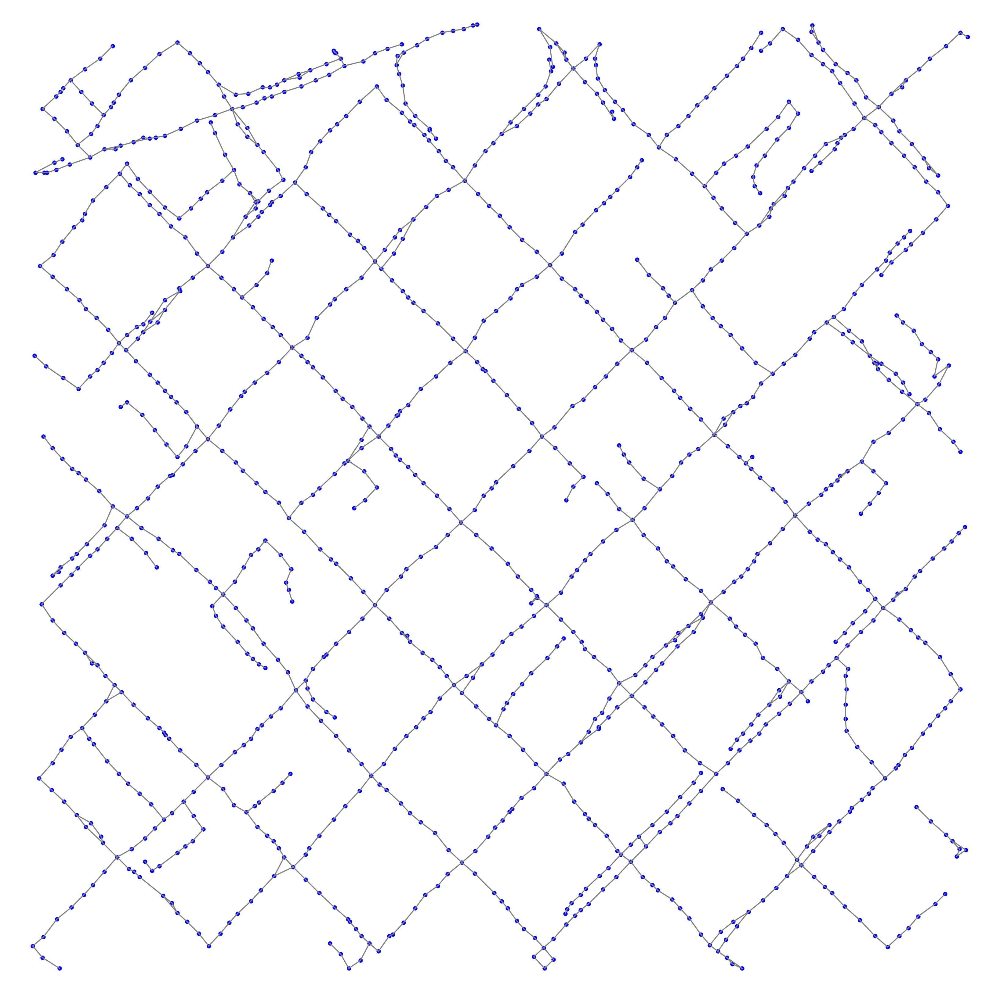

In [11]:
s2g.plot_graph()

In [12]:
def process_trip_files_mapconstruction(folder_path: str):
    """
    Processes all trip files in the specified folder and creates corresponding Graphs.
    
    Parameters:
    - folder_path (str): The path to the folder containing trip files.
    
    Returns:
    - Dict[str, Graph]: A dictionary mapping trip filenames to their Graph instances.
    """
    trip_graphs = {}
    total_trips = 0
    
    # List all files in the folder
    for filename in os.listdir(folder_path):
        if (filename.startswith("trip_") or filename.startswith("track_")) and filename.endswith(".txt"):
            file_path = os.path.join(folder_path, filename)
            #print(f"Processing {file_path}...")

            trip_number = int(filename.split('_')[1].split('.')[0])
            print(f"trip number: {trip_number}")
            
            # Initialize a new Graph instance for this trip
            graph = Graph()
            
            # Read the trip file and add nodes and edges
            with open(file_path, 'r') as file:
                previous_node = None
                for line_number, line in enumerate(file, 1):
                    parts = line.strip().split()
                    if len(parts) != 3:
                        print(f"Warning: Line {line_number} in {filename} is malformed: '{line.strip()}'")
                        continue  # Skip malformed lines
                    
                    try:
                        x, y, timestamp = float(parts[0]), float(parts[1]), float(parts[2])
                        current_node = (int(x), int(y))
                        
                        # Add the current node to the graph
                        graph.add_node(current_node)
                        
                        # If there's a previous node, connect it to the current node
                        if previous_node is not None:
                            graph.add_edge(previous_node, current_node)
                        
                        # Update the previous node
                        previous_node = current_node
                    except ValueError:
                        print(f"Warning: Line {line_number} in {filename} contains non-numeric data: '{line.strip()}'")
                        continue  # Skip lines with non-numeric data
            
            # Store the graph in the dictionary
            trip_graphs[trip_number] = graph
            #print(f"Graph for {filename} created with {len(graph.graph)} nodes.\n")
            total_trips += 1

    print(f"{total_trips} trips processed")
    return trip_graphs

In [13]:
def process_trip_files_wikiloc(folder_path: str):
    """
    Processes all trip files in the specified folder and creates corresponding Graphs.
    
    Parameters:
    - folder_path (str): The path to the folder containing trip files.
    
    Returns:
    - Dict[str, Graph]: A dictionary mapping trip filenames to their Graph instances.
    """
    trip_graphs = {}
    total_trips = 0

    # Define the GPX namespace
    namespace = {'default': 'http://www.topografix.com/GPX/1/1'}
    
    # List all files in the folder
    for filename in os.listdir(folder_path):
        if filename.endswith(".gpx"):
            file_path = os.path.join(folder_path, filename)
            print(f"Processing {file_path}...")

            trip_number = total_trips
            graph = Graph()
            previous_node = None

            try:
                # Parse the GPX file
                tree = ET.parse(file_path)
                root = tree.getroot()
        
                # Find all track points
                trkpts = root.findall('.//default:trkpt', namespace)
        
                points = []
                for trkpt in trkpts:
                    # Extract latitude and longitude
                    lat = float(trkpt.attrib['lat'])
                    lon = float(trkpt.attrib['lon'])
        
                    # Extract and parse the timestamp
                    time_element = trkpt.find('default:time', namespace)
                    if time_element is not None:
                        time_str = time_element.text
                        try:
                            # Use dateutil to parse the timestamp
                            time_obj = date_parser.isoparse(time_str)
                            points.append((time_obj, lat, lon))
                        except ValueError as ve:
                            print(f"Warning: Unable to parse timestamp '{time_str}'. Skipping this track point.")
                    else:
                        print("Warning: Track point without a timestamp found and skipped.")
        
                if not points:
                    print("No valid track points with timestamps found in the GPX file.")
                    return []
        
                # Sort the points by timestamp
                points_sorted = sorted(points, key=lambda x: x[0])
        
                # Determine the UTM zone based on the first point
                first_lon = points_sorted[0][2]
                first_lat = points_sorted[0][1]
                utm_zone = int((first_lon + 180) / 6) + 1
                hemisphere = 'north' if first_lat >= 0 else 'south'
        
                # Define the EPSG code for the determined UTM zone
                if hemisphere == 'north':
                    epsg_code = f"326{utm_zone:02d}"  # Northern hemisphere
                else:
                    epsg_code = f"327{utm_zone:02d}"  # Southern hemisphere
        
                # Initialize the transformer
                transformer = Transformer.from_crs("epsg:4326", f"epsg:{epsg_code}", always_xy=True)
        
                utm_points = []
                for _, lat, lon in points_sorted:
                    easting, northing = transformer.transform(lon, lat)
                    utm_points.append((easting, northing))
        
                for node in utm_points:
                    graph.add_node(node)
                    if previous_node is not None:
                        graph.add_edge(previous_node, node)
                    previous_node = node

                trip_graphs[trip_number] = graph
                total_trips += 1
        
            except ET.ParseError as pe:
                print(f"Error parsing the GPX file: {pe}")
                return []
            except FileNotFoundError:
                print(f"File not found: {gpx_file_path}")
                return []
            except Exception as e:
                print(f"An unexpected error occurred: {e}")
                return []

    print(f"{total_trips} trips processed")
    return trip_graphs

In [14]:
# Define the folder containing trip files
trips_folder = "/Users/carlesbalsach/FIB/TFG/GeoFusion Maps/Data/Tracks/BcnEixample/gap_hospital"

# Process trip files and create graphs
#trip_graphs = process_trip_files_mapconstruction(trips_folder)
trip_graphs = process_trip_files_wikiloc(trips_folder)

# Trim the trips within the boundaries of the original graph
blbound, trbound = s2g.get_bounds()
for trip in trip_graphs.values():
    trip.trim(blbound, trbound)

print("All trip files have been processed.")

Processing /Users/carlesbalsach/FIB/TFG/GeoFusion Maps/Data/Tracks/BcnEixample/gap_hospital/parroquia-de-santa-teresa-del-nen-jesus-jardins-palau-robert.gpx...
Processing /Users/carlesbalsach/FIB/TFG/GeoFusion Maps/Data/Tracks/BcnEixample/gap_hospital/de-tres-torres-a-la-placa-sant-jaume.gpx...
Processing /Users/carlesbalsach/FIB/TFG/GeoFusion Maps/Data/Tracks/BcnEixample/gap_hospital/safari-urba-leixample-de-barcelona.gpx...
Processing /Users/carlesbalsach/FIB/TFG/GeoFusion Maps/Data/Tracks/BcnEixample/gap_hospital/volta-per-leixample-esquerra.gpx...
Processing /Users/carlesbalsach/FIB/TFG/GeoFusion Maps/Data/Tracks/BcnEixample/gap_hospital/pl-vila-pl-catalunya.gpx...
Processing /Users/carlesbalsach/FIB/TFG/GeoFusion Maps/Data/Tracks/BcnEixample/gap_hospital/barri-gotic-palau-de-la-generalitat-catedral-de-barcelona-la.gpx...
Processing /Users/carlesbalsach/FIB/TFG/GeoFusion Maps/Data/Tracks/BcnEixample/gap_hospital/arago-balmes-paris-a-av-terradelles.gpx...
Processing /Users/carlesbal

In [15]:
trip_graphs[0].peak()

Graph Structure:
  (428929, 4582857) --> [(428932, 4582857)]
  (428932, 4582857) --> [(428929, 4582857), (428936, 4582854)]
  (428936, 4582854) --> [(428932, 4582857), (428939, 4582853)]
  (428939, 4582853) --> [(428936, 4582854), (428941, 4582851)]
  (428941, 4582851) --> [(428939, 4582853), (428944, 4582851)]
  (428944, 4582851) --> [(428941, 4582851), (428945, 4582853)]
  (428945, 4582853) --> [(428944, 4582851), (428946, 4582857)]
  (428946, 4582857) --> [(428945, 4582853), (428946, 4582859)]
  (428946, 4582859) --> [(428946, 4582857), (428948, 4582861)]
  (428948, 4582861) --> [(428946, 4582859), (428950, 4582863)]
  (428950, 4582863) --> [(428948, 4582861), (428952, 4582863)]


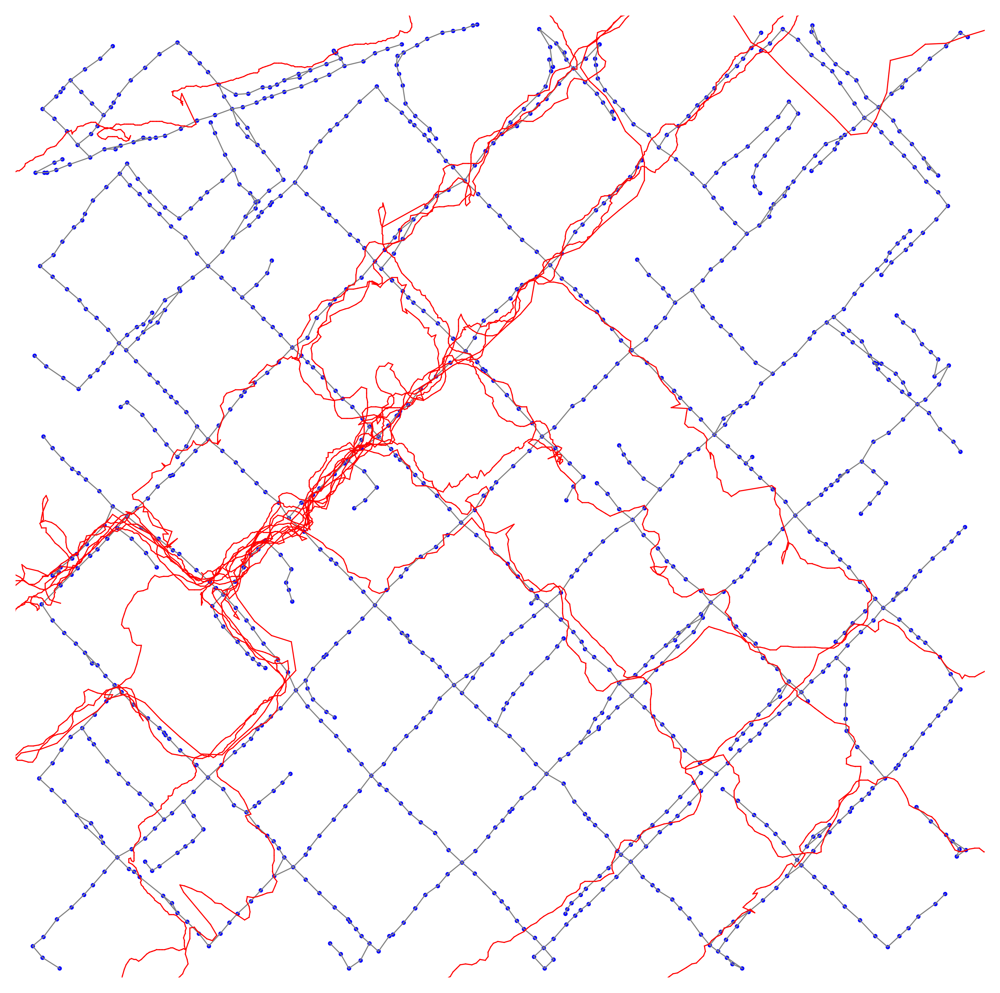

In [16]:
s2g.plot_graph(trip_graphs)

In [17]:
kdtree = s2g.get_points_sorted()
for graph in trip_graphs.values():
    graph.snap(kdtree)

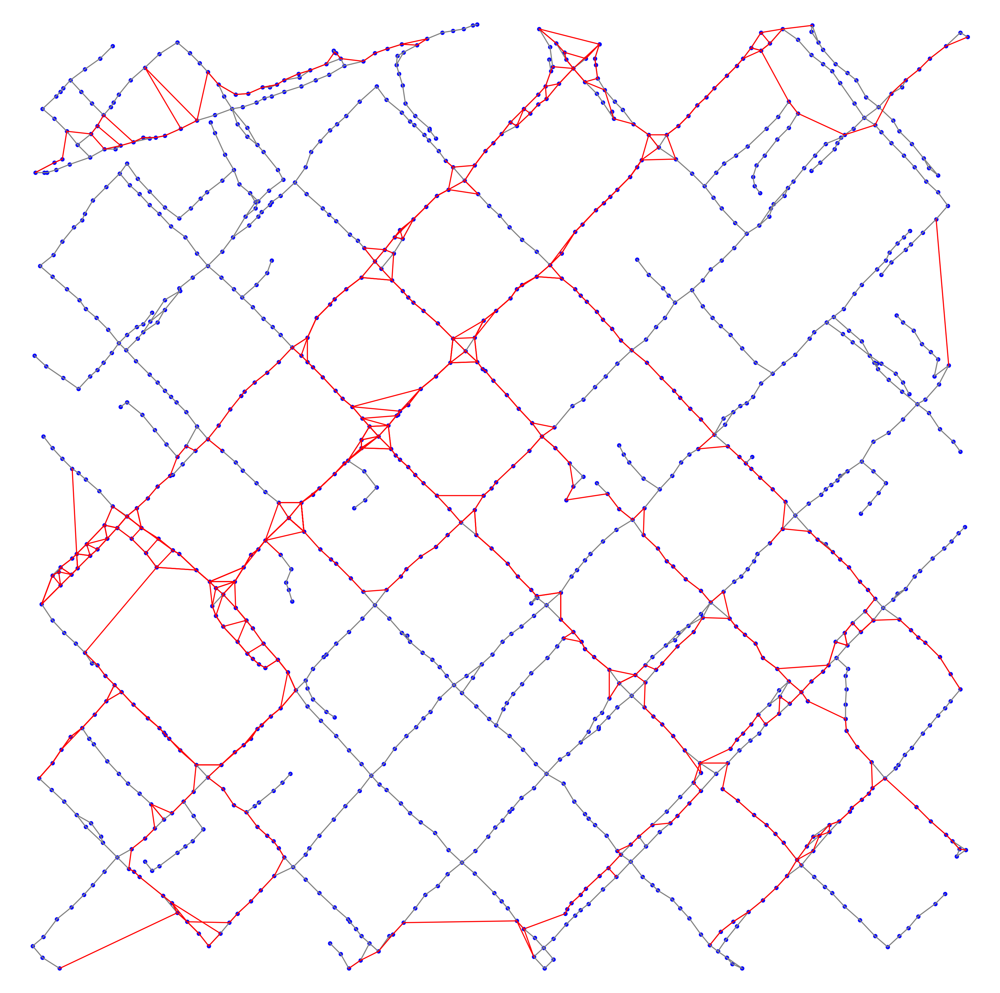

In [18]:
s2g.plot_graph(trip_graphs)

In [19]:
s2g.patch_bridges(trip_graphs)

((np.int64(429237), np.int64(4582454)), (np.int64(429263), np.int64(4582479)))
((np.int64(429263), np.int64(4582479)), (np.int64(429237), np.int64(4582454)))


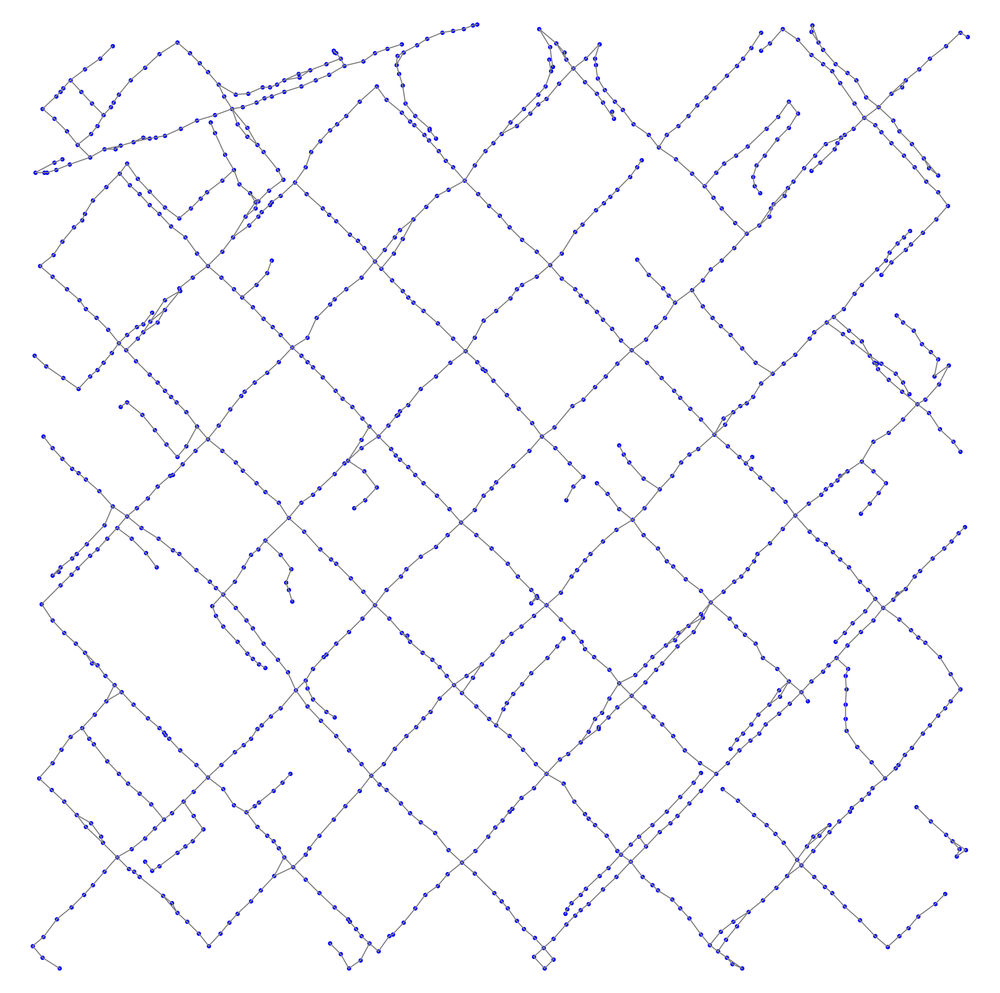

In [20]:
s2g.plot_graph()

In [21]:
# Define the folder containing trip files
trips_folder = "/Users/carlesbalsach/FIB/TFG/GeoFusion Maps/Data/Tracks/RamblaCat"

# Process trip files and create graphs
#trip_graphs = process_trip_files_mapconstruction(trips_folder)
trip_graphs = process_trip_files_wikiloc(trips_folder)

# Trim the trips within the boundaries of the original graph
blbound, trbound = s2g.get_bounds()
for trip in trip_graphs.values():
    trip.trim(blbound, trbound)

print("All trip files have been processed.")

Processing /Users/carlesbalsach/FIB/TFG/GeoFusion Maps/Data/Tracks/RamblaCat/pujada-al-tibidabo-parc-natural-de-collserola-barcelona-mont.gpx...
Processing /Users/carlesbalsach/FIB/TFG/GeoFusion Maps/Data/Tracks/RamblaCat/gracia-port-vell-world-trade-center-barcelona-2016-10-12-8-1.gpx...
Processing /Users/carlesbalsach/FIB/TFG/GeoFusion Maps/Data/Tracks/RamblaCat/dia-3er-marxa-per-la-llibertat-martorell-barcelona.gpx...
Processing /Users/carlesbalsach/FIB/TFG/GeoFusion Maps/Data/Tracks/RamblaCat/ruta-cultural-modernista-de-la-mano-del-arquitecto-domenech-.gpx...
Processing /Users/carlesbalsach/FIB/TFG/GeoFusion Maps/Data/Tracks/RamblaCat/ruta-turistica-per-barcelona.gpx...
Processing /Users/carlesbalsach/FIB/TFG/GeoFusion Maps/Data/Tracks/RamblaCat/ronda-004-del-club-a-casa.gpx...
Processing /Users/carlesbalsach/FIB/TFG/GeoFusion Maps/Data/Tracks/RamblaCat/passeig-per-barcelona.gpx...
Processing /Users/carlesbalsach/FIB/TFG/GeoFusion Maps/Data/Tracks/RamblaCat/sant-jordi-21.gpx...
Pro

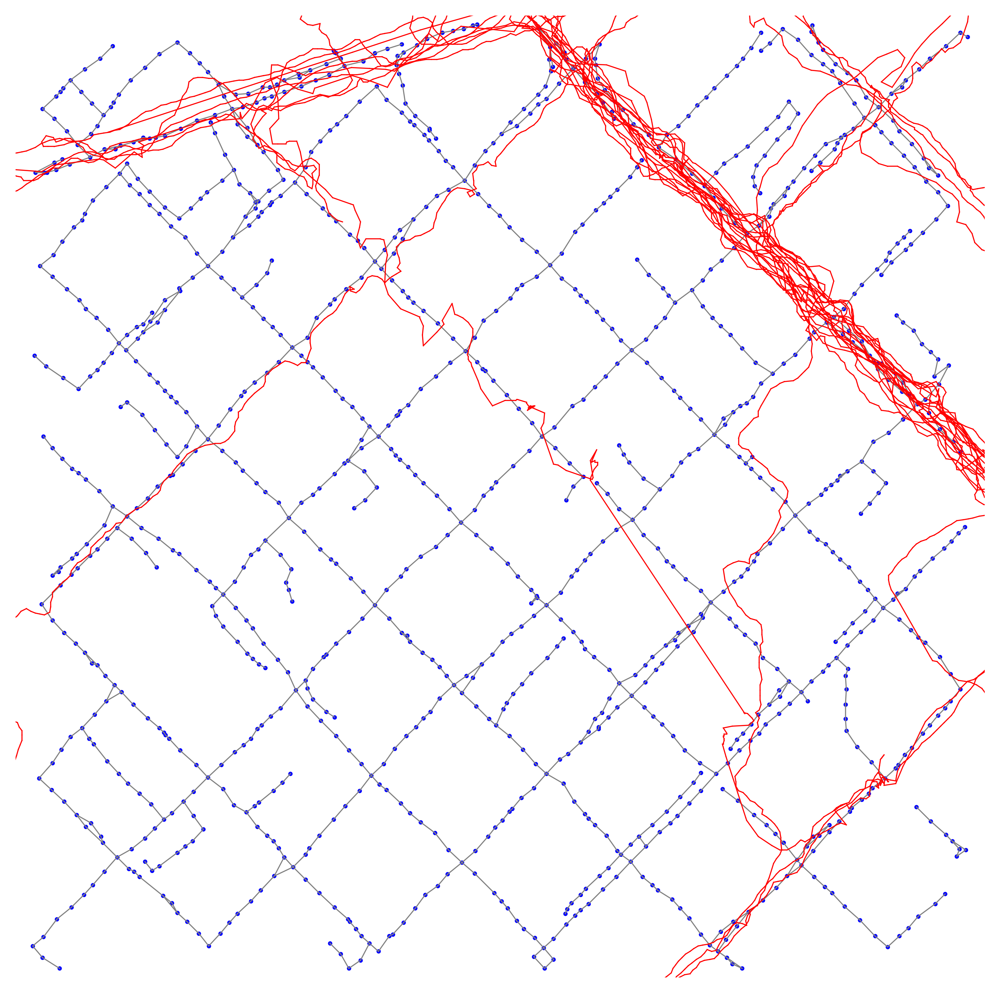

In [22]:
s2g.plot_graph(trip_graphs)

In [23]:
kdtree = s2g.get_points_sorted()
for graph in trip_graphs.values():
    graph.snap(kdtree)

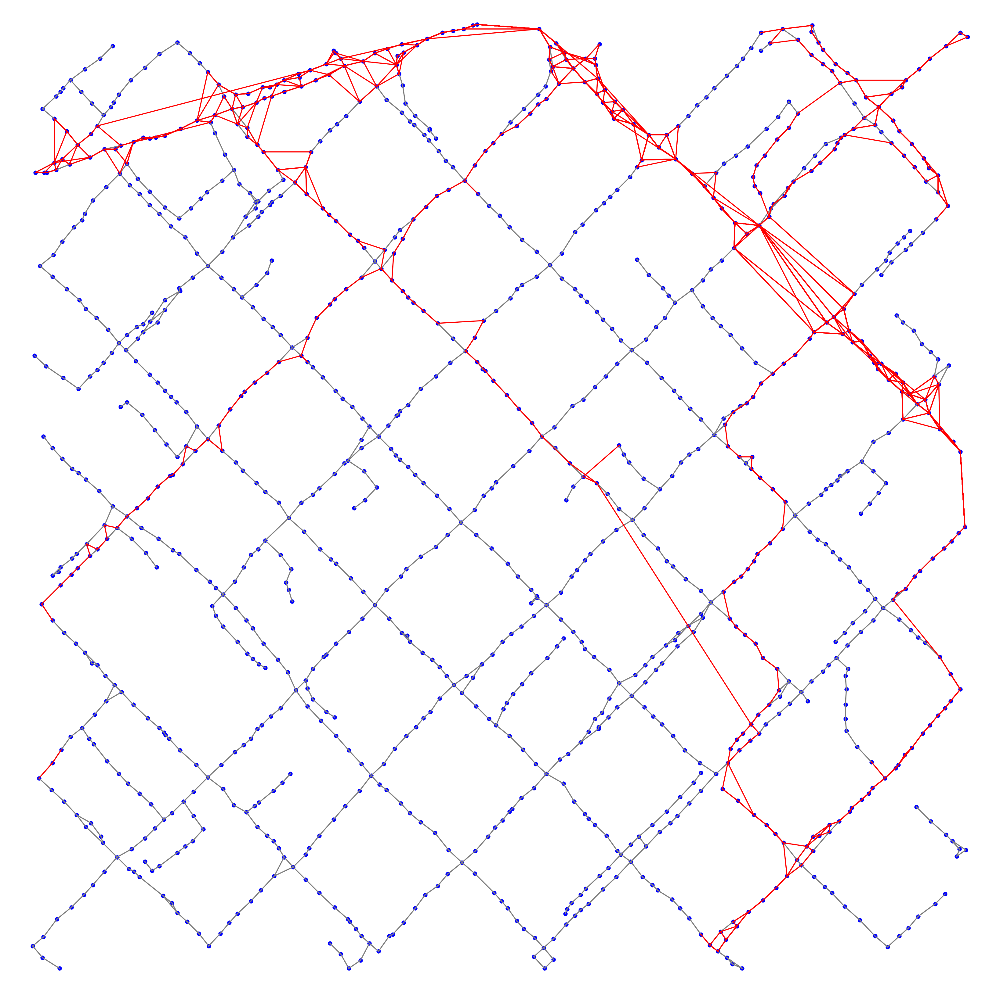

In [24]:
s2g.plot_graph(trip_graphs)

In [25]:
s2g.patch_bridges(trip_graphs)

((np.int64(429625), np.int64(4582924)), (np.int64(429647), np.int64(4582918)))
((np.int64(429647), np.int64(4582918)), (np.int64(429625), np.int64(4582924)))
((np.int64(429656), np.int64(4582878)), (np.int64(429694), np.int64(4582879)))
((np.int64(429694), np.int64(4582879)), (np.int64(429656), np.int64(4582878)))
((np.int64(429787), np.int64(4582805)), (np.int64(429862), np.int64(4582697)))
((np.int64(429862), np.int64(4582697)), (np.int64(429787), np.int64(4582805)))
((np.int64(430011), np.int64(4582553)), (np.int64(430016), np.int64(4582469)))
((np.int64(430016), np.int64(4582469)), (np.int64(430011), np.int64(4582553)))
((np.int64(429862), np.int64(4582697)), (np.int64(429870), np.int64(4582703)))
((np.int64(429870), np.int64(4582703)), (np.int64(429881), np.int64(4582712)))
((np.int64(429870), np.int64(4582703)), (np.int64(429862), np.int64(4582697)))
((np.int64(429881), np.int64(4582712)), (np.int64(429870), np.int64(4582703)))
((np.int64(429946), np.int64(4582620)), (np.int64(42

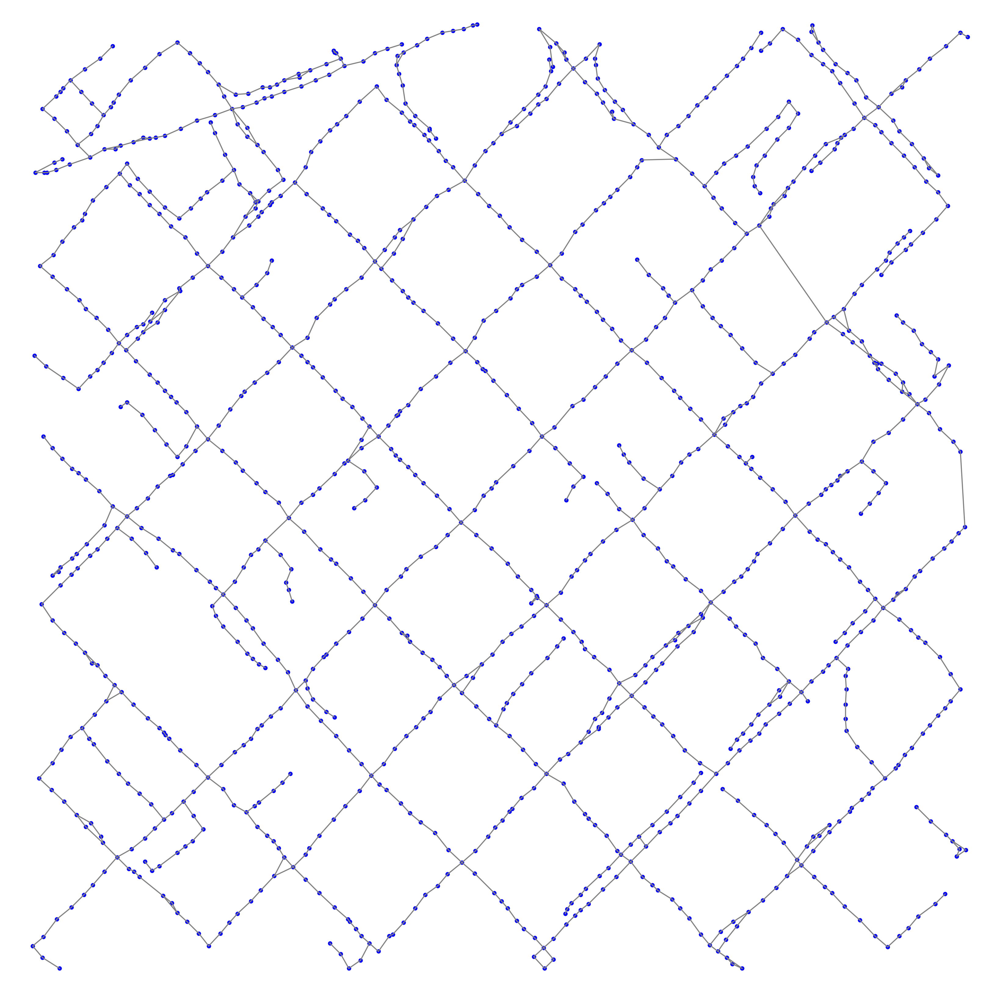

In [26]:
s2g.plot_graph()

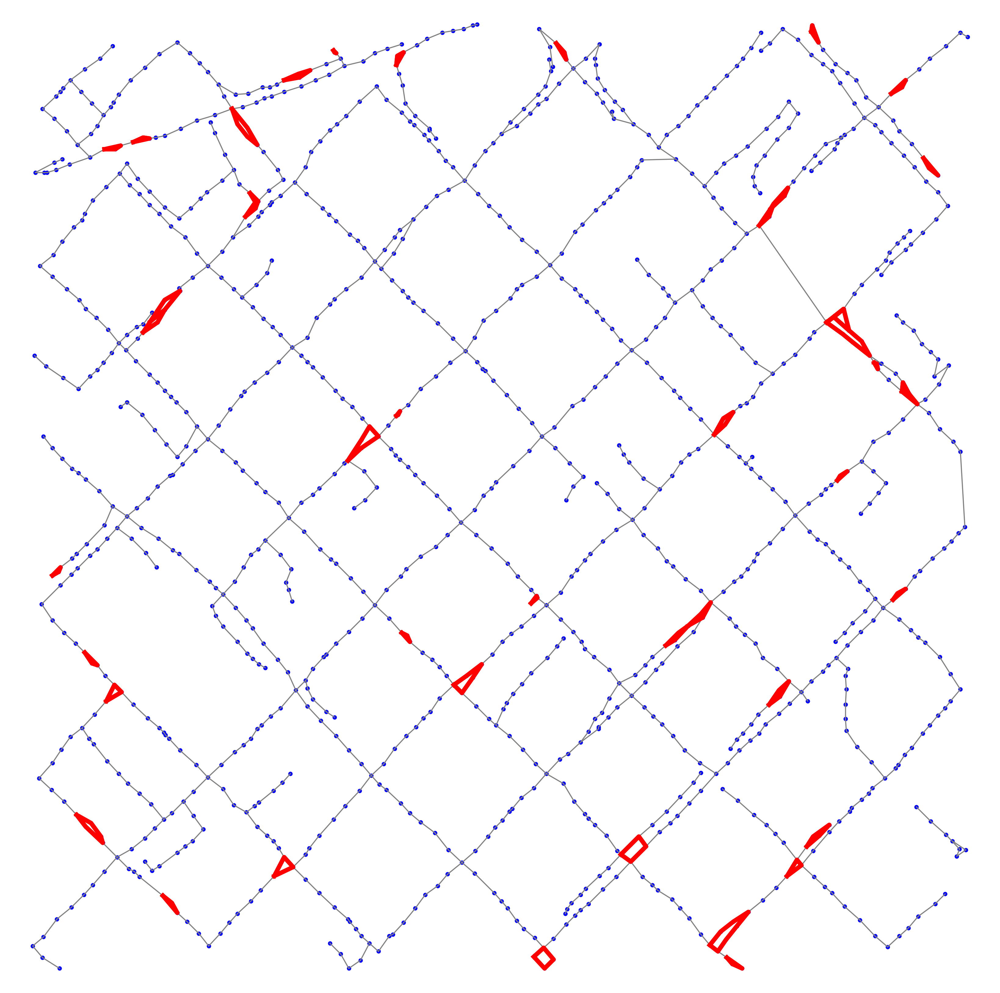

In [27]:
# DETECTING AND FIXING CLOSED LOOPS
loops = s2g.find_all_cycles_between(3,7)
s2g.plot_graph(loops=loops)

In [28]:
finished = False
while not finished:
    nodeDeleted = False
    for loop in loops:
        for node in loop:
            nodeDeleted = s2g.delete_node_based_on_connections(node) or nodeDeleted
            
    if not nodeDeleted:
        finished = True
    else:
        loops = s2g.find_all_cycles_between(3,7)

Node (np.int64(429757), np.int64(4581982)) deleted (double connections).
Node (np.int64(429768), np.int64(4581977)) deleted (single connection).
Node (np.int64(429533), np.int64(4582384)) deleted (double connections).
Node (np.int64(429540), np.int64(4582390)) deleted (double connections).
Node (np.int64(429539), np.int64(4582392)) deleted (double connections).
Node (np.int64(429536), np.int64(4581990)) deleted (double connections).
Node (np.int64(429548), np.int64(4581977)) deleted (double connections).
Node (np.int64(429558), np.int64(4581987)) deleted (single connection).
Node (np.int64(429547), np.int64(4582000)) deleted (double connections).
Node (np.int64(429226), np.int64(4582824)) deleted (double connections).
Node (np.int64(429976), np.int64(4582869)) deleted (double connections).
Node (np.int64(429986), np.int64(4582861)) deleted (single connection).
Node (np.int64(429845), np.int64(4583021)) deleted (double connections).
Node (np.int64(429853), np.int64(4583009)) deleted (do

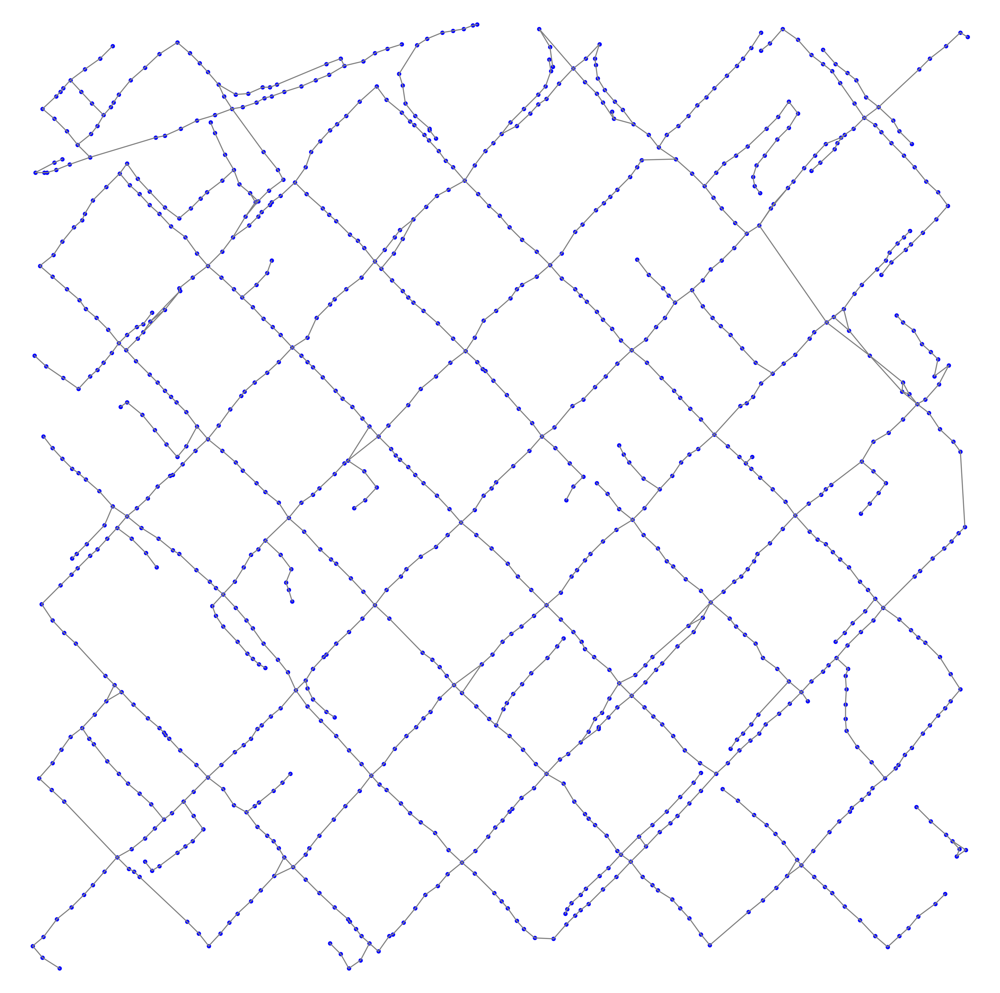

In [29]:
loops = s2g.find_all_cycles_between(3,7)
s2g.plot_graph()

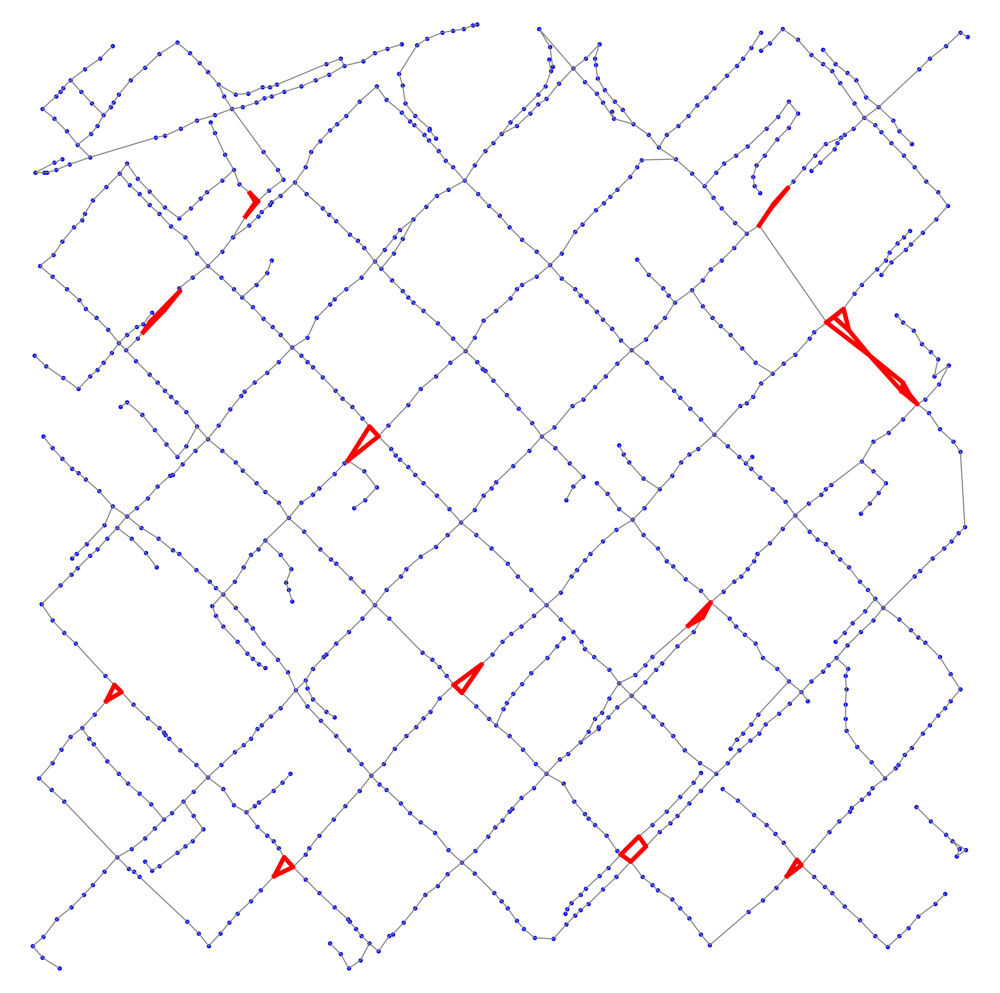

In [30]:
s2g.plot_graph(loops=loops)

Graph successfully loaded from /Users/carlesbalsach/FIB/TFG/GeoFusion Maps/Data/BcnEixample/graph.p.
Coordinates swapped in the graph.
Graph Structure:
  (509, 1052) --> [(504, 1051)]
  (504, 1051) --> [(494, 1047), (509, 1052)]
  (882, 1051) --> [(889, 1032), (881, 1044)]
  (494, 1047) --> [(482, 1045), (504, 1051)]
  (578, 1047) --> [(590, 1027), (597, 1031)]
  (849, 1047) --> [(835, 1031), (866, 1035)]
  (482, 1045) --> [(494, 1047), (470, 1043)]
  (881, 1044) --> [(889, 1032), (882, 1051)]
  (470, 1043) --> [(482, 1045), (453, 1036)]
  (825, 1043) --> [(814, 1026)]
  (1047, 1043) --> [(1031, 1028), (1055, 1038)]
UTM Easting: 428974, UTM Northing: 4582002, Zone: 31N
Graph shifted by (428974, 4582002).
Graph shifted by (-10, -25).
Graph Structure:
  (429473, 4583029) --> [(429468, 4583028)]
  (429468, 4583028) --> [(429458, 4583024), (429473, 4583029)]
  (429846, 4583028) --> [(429853, 4583009), (429845, 4583021)]
  (429458, 4583024) --> [(429446, 4583022), (429468, 4583028)]
  (4295

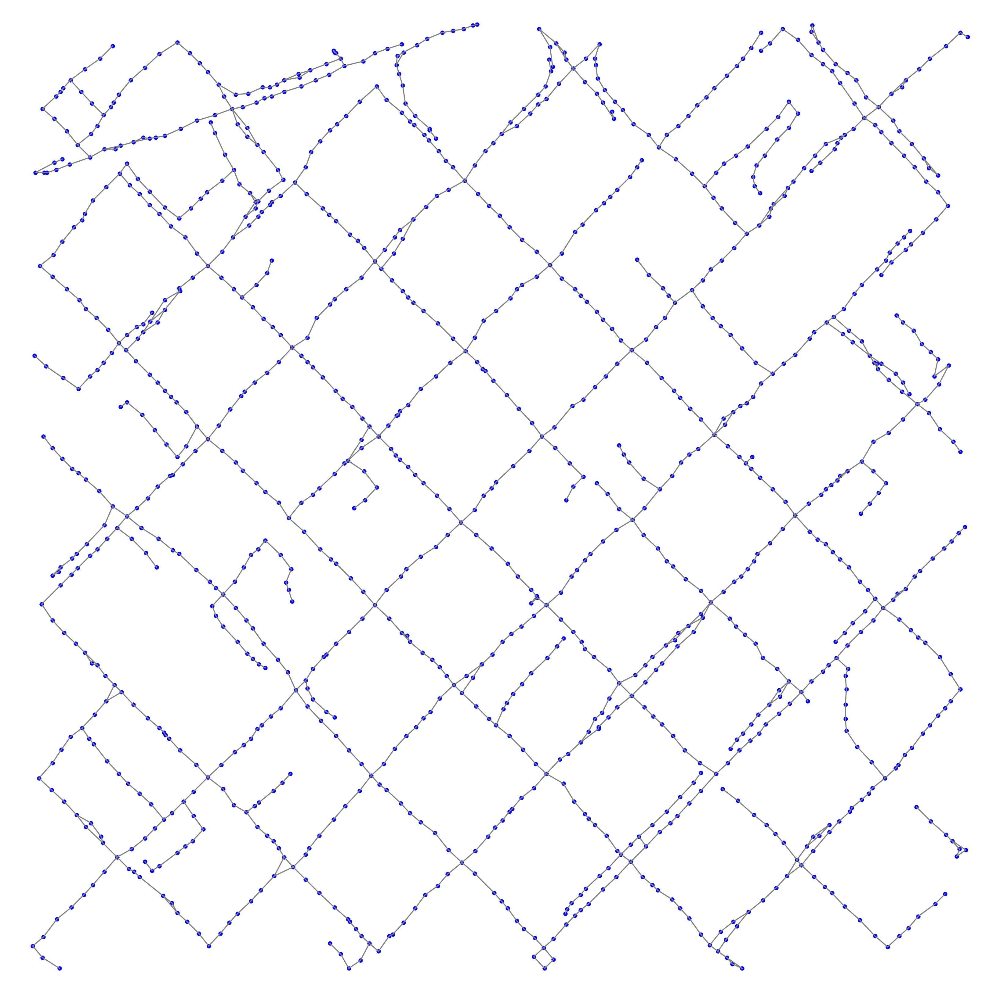

In [31]:
g_eix = Graph()
g_eix.load_graph(data_path, graph_file)
g_eix.fix_s2f_coordinates()
g_eix.peak()
easting, northing, zone = latlon_to_utm(gmd.lat, gmd.lon)
easting = int(easting)
northing = int(northing)
print(f"UTM Easting: {easting}, UTM Northing: {northing}, Zone: {zone}")
g_eix.shift_graph(easting, northing)
# Eixample
g_eix.shift_graph(-10, -25)
g_eix.peak()
print(g_eix.get_bounds())
g_eix.plot_graph()

# Save a copy of the initial grpah
g_init = Graph()
g_init.copy(g_eix)

trip number: 9
trip number: 8
trip number: 18
trip number: 19
trip number: 14
trip number: 0
trip number: 1
trip number: 15
trip number: 3
trip number: 17
trip number: 16
trip number: 2
trip number: 6
trip number: 12
trip number: 13
trip number: 7
trip number: 11
trip number: 5
trip number: 4
trip number: 10
20 trips processed
All trip files have been processed.
Graph Structure:
  (428978, 4582014) --> [(428989, 4581998)]
  (428989, 4581998) --> [(428978, 4582014), (428985, 4582017)]
  (428985, 4582017) --> [(428989, 4581998), (428986, 4582025)]
  (428986, 4582025) --> [(428985, 4582017), (428995, 4582012)]
  (428995, 4582012) --> [(428986, 4582025), (429006, 4582026)]
  (429006, 4582026) --> [(428995, 4582012), (429006, 4582017)]
  (429006, 4582017) --> [(429006, 4582026), (429014, 4582040)]
  (429014, 4582040) --> [(429006, 4582017), (429011, 4582044)]
  (429011, 4582044) --> [(429014, 4582040), (429010, 4582040)]
  (429010, 4582040) --> [(429011, 4582044), (429016, 4582048)]
  (4290

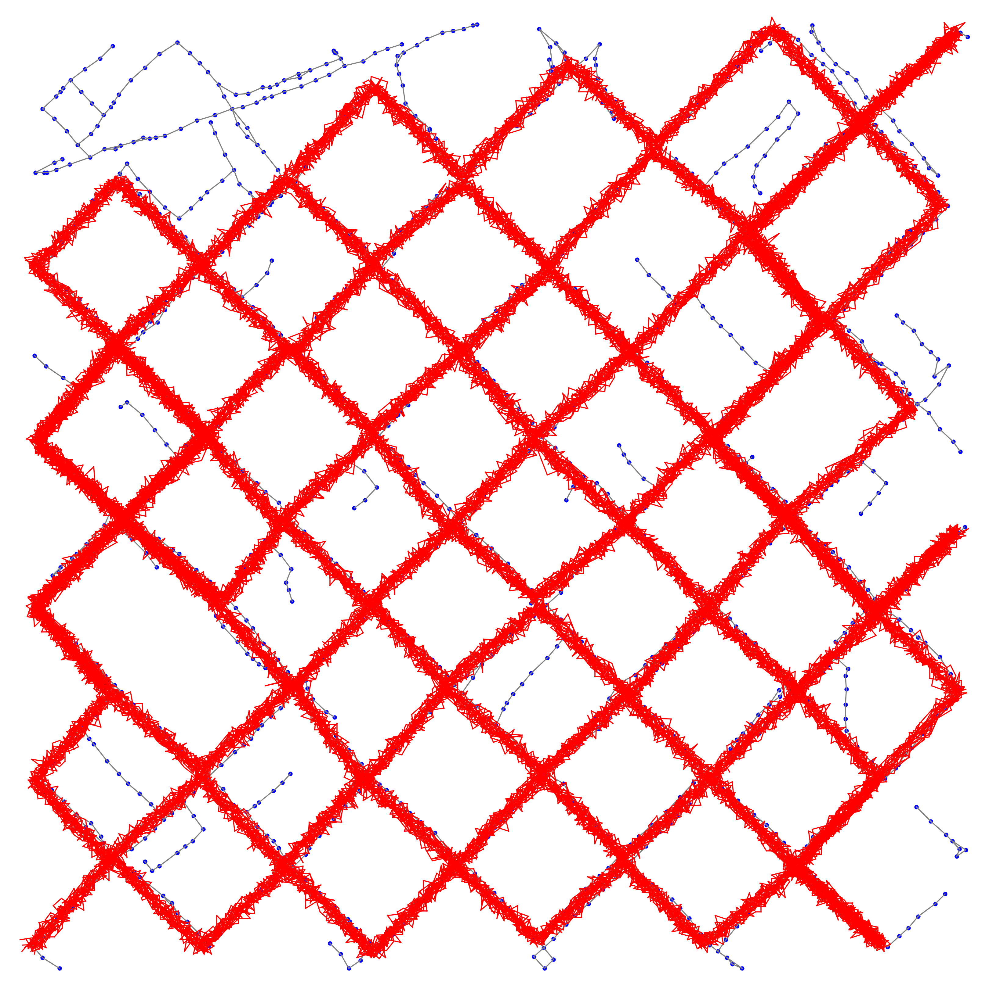

In [32]:
# Define the folder containing trip files
trips_folder = "/Users/carlesbalsach/FIB/TFG/GeoFusion Maps/Data/Tracks/Synth"

# Process trip files and create graphs
trip_graphs = process_trip_files_mapconstruction(trips_folder)

print("All trip files have been processed.")

trip_graphs[0].peak()

print(g_eix.get_bounds())
print(trip_graphs[0].get_bounds())

g_eix.plot_graph(trip_graphs)

In [33]:
# CREATE KD-TREE FOR EFICIENCY
kdtree = g_eix.get_points_sorted()
for graph in trip_graphs.values():
    graph.snap(kdtree)

# CLEAN GRAPH
g_eix.clean_nodes(trip_graphs)
g_eix.delete_isolated_isles()

# PATCH MISSING ZONES
g_eix.patch_bridges(trip_graphs, 7, 15)

# DETECTING AND FIXING CLOSED LOOPS
loops = g_eix.find_all_cycles_between(3,7)
finished = False
while not finished:
    nodeDeleted = False
    for loop in loops:
        for node in loop:
            nodeDeleted = g_eix.delete_node_based_on_connections(node) or nodeDeleted
            
    if not nodeDeleted:
        finished = True
    else:
        loops = g_eix.find_all_cycles_between(3,7)

Removed 248 nodes with fewer than 2 trip graphs snapping to them.
Found a connected component with 892 nodes.
Found a connected component with 1 nodes.
Found a connected component with 2 nodes.
Found a connected component with 2 nodes.
Found a connected component with 2 nodes.
Found a connected component with 1 nodes.
Found a connected component with 1 nodes.
Found a connected component with 1 nodes.
Found a connected component with 1 nodes.
Deleted 11 nodes from 8 isolated components of size <= 3.
((np.int64(429752), np.int64(4582206)), (np.int64(429755), np.int64(4582222)))
((np.int64(429755), np.int64(4582222)), (np.int64(429752), np.int64(4582206)))
((np.int64(429841), np.int64(4582275)), (np.int64(429883), np.int64(4582255)))
((np.int64(429883), np.int64(4582255)), (np.int64(429841), np.int64(4582275)))
((np.int64(429237), np.int64(4582454)), (np.int64(429263), np.int64(4582479)))
((np.int64(429263), np.int64(4582479)), (np.int64(429237), np.int64(4582454)))
((np.int64(429862), np

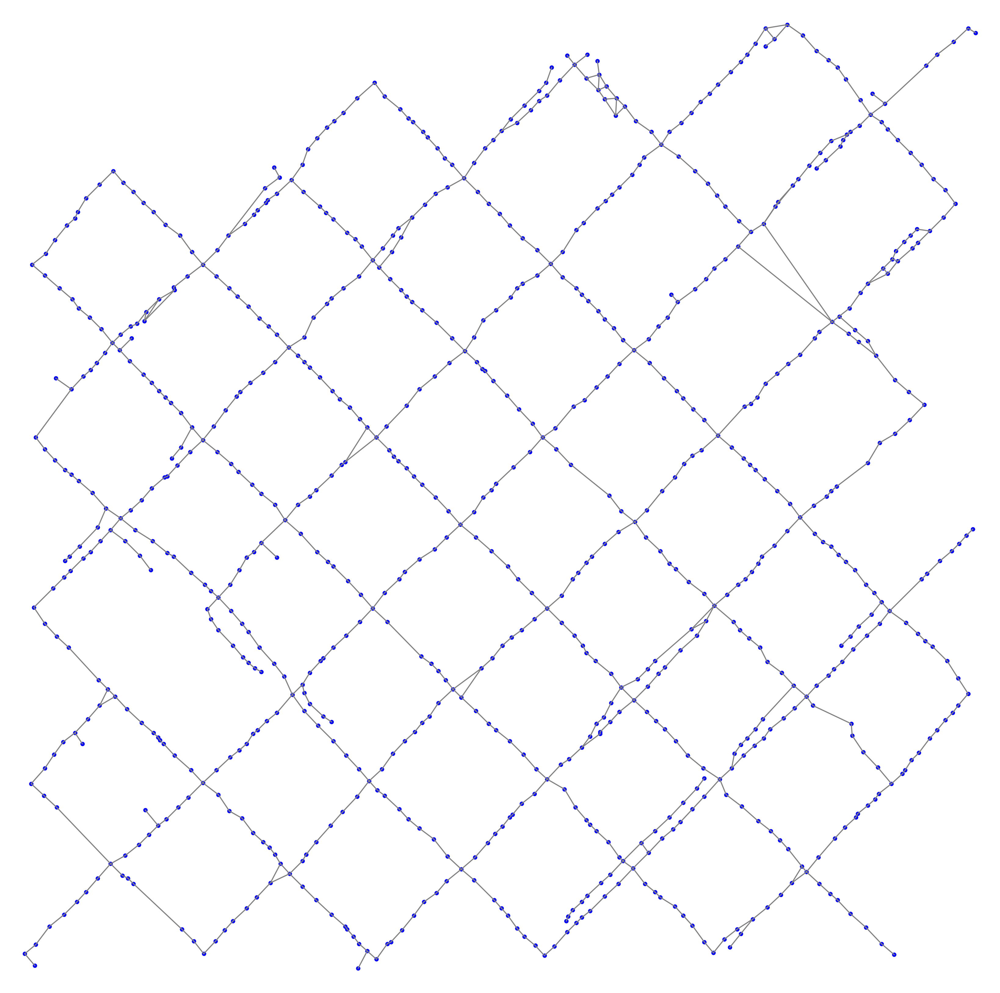

In [34]:
g_eix.plot_graph()

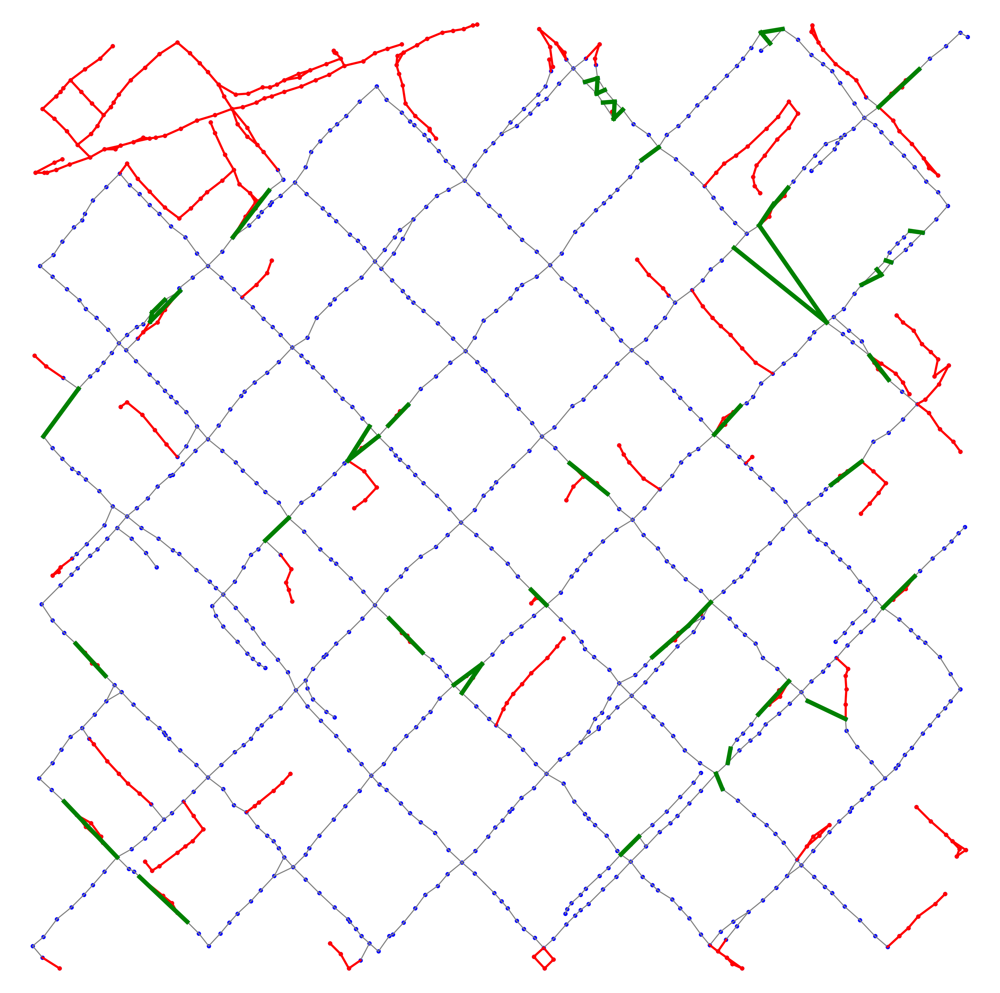

In [35]:
g_init.plot_graph_diff(g_eix)